In [13]:
# Common imports
import numpy as np
import os
from stable_baselines3.common.callbacks import EvalCallback
from stable_baselines3.common.monitor import Monitor, ResultsWriter
# To plot pretty figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# To get smooth animations
import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')
##########  Using gym
import gym

# Scikit-Learn ≥0.20 is required
import sklearn

# TensorFlow ≥2.0 is required
import tensorflow as tf
from tensorflow import keras

# to make this notebook's output stable across runs
np.random.seed(42)

In [14]:
# Let's build the DQN. 
# Given a state, it will estimate, for each possible action, the sum of discounted future rewards it can expect after 
# it plays that action (but before it sees its outcome):

keras.backend.clear_session()
tf.random.set_seed(42)
np.random.seed(42)

env = gym.make("ALE/MsPacman-ram-v5",render_mode="rgb_array")


In [15]:
train_monitor = Monitor(env, filename="monitors/ddqn_train")
test_monitor = Monitor(env, filename="monitors/ddqn_test")

In [16]:
train_monitor.observation_space.shape

(128,)

In [17]:
input_shape = train_monitor.observation_space.shape # == env.observation_space.shape
n_outputs = train_monitor.action_space.n # == env.action_space.n

model = keras.models.Sequential([
    keras.layers.Dense(256, activation="elu", input_shape=input_shape),
    keras.layers.Dense(128, activation="elu", input_shape=input_shape),
    keras.layers.Dense(32, activation="elu"),
    keras.layers.Dense(n_outputs)
])

target = keras.models.clone_model(model)  # NEW It is a clone of the online model
target.set_weights(model.get_weights())   # NEW

In [18]:
# To select an action using this DQN, we just pick the action with the largest predicted Q-value. However, to ensure that 
# the agent explores the environment, we choose a random action with probability epsilon.

def epsilon_greedy_policy(state, epsilon):
    if np.random.rand() < epsilon:
        return np.random.randint(n_outputs)
    else:
        Q_values = model.predict(state[np.newaxis], verbose=0)
        # print("Q_values", Q_values)
        return np.argmax(Q_values)

In [19]:
# We will also need a replay memory. It will contain the agent's experiences, 
# in the form of tuples: (obs, action, reward, next_obs, done). 
# We can use the deque class for that (but make sure to check out DeepMind's excellent Reverb library for 
# a much more robust implementation of experience replay):

from collections import deque

replay_memory = deque(maxlen=5000)

In [20]:
# And let's create a function to sample experiences from the replay memory. It will return 5 NumPy arrays: 
# [obs, actions, rewards, next_obs, dones].

def sample_experiences(batch_size):
    indices = np.random.randint(len(replay_memory), size=batch_size)
    batch = [replay_memory[index] for index in indices]
    states, actions, rewards, next_states, dones = [
        np.array([experience[field_index] for experience in batch])
        for field_index in range(5)]
    return states, actions, rewards, next_states, dones

In [21]:
# Now we can create a function that will use the DQN to play one step, and record its experience in the replay memory:
def play_one_step(env, state, epsilon):
    action = epsilon_greedy_policy(state, epsilon)
    next_state, reward, done, tr,info = env.step(action)
    replay_memory.append((state, action, reward, next_state, done))
    return next_state, reward, done, info, env.render()

In [22]:
# Lastly, let's create a function that will sample some experiences from the replay memory and perform a training step:

batch_size = 32
discount_rate = 0.95
optimizer = keras.optimizers.Adam(learning_rate=1e-2)
loss_fn = keras.losses.mean_squared_error

def training_step(batch_size):
    experiences = sample_experiences(batch_size)
    states, actions, rewards, next_states, dones = experiences
    #next_Q_values = model.predict(next_states)  # ORIGINAL DQN
    next_Q_values = target.predict(next_states, verbose=0)  # NEW  Using the target model instead the online model 
    max_next_Q_values = np.max(next_Q_values, axis=1)
    target_Q_values = (rewards +
                       (1 - dones) * discount_rate * max_next_Q_values)
    target_Q_values = target_Q_values.reshape(-1, 1)
    mask = tf.one_hot(actions, n_outputs)
    with tf.GradientTape() as tape:
        all_Q_values = model(states)   # Use of the online model
        Q_values = tf.reduce_sum(all_Q_values * mask, axis=1, keepdims=True)
        loss = tf.reduce_mean(loss_fn(target_Q_values, Q_values))
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

In [23]:
from tqdm import tqdm
import time

In [24]:
rewards = []
frames = []
best_score = 0
for episode in range(250):
    start_time = time.time()
    obs = train_monitor.reset() 
    obs = obs[0]
    for step in range(1000):
        epsilon = max(1 - episode / 250, 0.01)
        obs, reward, done, info, frame = play_one_step(train_monitor, obs, epsilon)
        rewards.append(reward) # Not shown in the book
        if episode >= 240:
            frames.append(frame)
        if done:
            break
        
    if step >= best_score: # Not shown
        best_weights = model.get_weights() # Not shown
        best_score = step # Not shown
    # print("\rEpisode: {}, Steps: {}, eps: {:.3f}".format(episode, step + 1, epsilon), end="") # Not shown
    #print(" Episodio vvvv", episode)
    if episode > 50:
        #print(" batch size vvvv", batch_size)      
        training_step(batch_size)
    if episode % 50 == 0:     ## Updating weights
        target.set_weights(model.get_weights())
    print(f"episode {episode} time {time.time() - start_time}")

model.set_weights(best_weights)
#2m.30 100
#10m 200
#20m 250

c:\Users\Alvaro\miniconda3\envs\rf_tf\lib\site-packages\gym\utils\passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(terminated, (bool, np.bool8)):
c:\Users\Alvaro\miniconda3\envs\rf_tf\lib\site-packages\gym\utils\passive_env_checker.py:289: UserWarning: WARN: No render fps was declared in the environment (env.metadata['render_fps'] is None or not defined), rendering may occur at inconsistent fps.
  logger.warn(


episode 0 time 0.15195465087890625
episode 1 time 0.44154930114746094
episode 2 time 0.22016286849975586
episode 3 time 0.3154599666595459
episode 4 time 0.26883625984191895
episode 5 time 0.48662304878234863
episode 6 time 0.4600703716278076
episode 7 time 0.4364585876464844
episode 8 time 0.4419517517089844
episode 9 time 0.4829719066619873
episode 10 time 0.6322174072265625
episode 11 time 0.44256162643432617
episode 12 time 0.6635417938232422
episode 13 time 0.75679612159729
episode 14 time 0.9471392631530762
episode 15 time 1.0880889892578125
episode 16 time 0.7983264923095703
episode 17 time 1.090993881225586
episode 18 time 0.8798313140869141
episode 19 time 1.528663158416748
episode 20 time 1.3108949661254883
episode 21 time 1.3614625930786133
episode 22 time 1.3809921741485596
episode 23 time 1.363332986831665
episode 24 time 1.27651047706604
episode 25 time 1.6409475803375244
episode 26 time 1.294135570526123
episode 27 time 2.768134355545044
episode 28 time 1.523062705993652

In [25]:
model.save("models/ddqn_mspacman.keras")

In [26]:
model = keras.models.load_model("models/ddqn_mspacman.keras")

In [27]:
# Now show the animation:
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)
plt.rcParams['animation.embed_limit'] = 80  # For example, set it to 30 MB

# To get smooth animations
import matplotlib.animation as animation
mpl.rc('animation', html='jshtml')
def update_scene(num, frames, patch):
    # print(num)
    patch.set_data(frames[num])
    return patch,

def plot_animation(frames, repeat=False, interval=40):
    fig = plt.figure()
    patch = plt.imshow(frames[0])
    plt.axis('off')
    anim = animation.FuncAnimation(
        fig, update_scene, fargs=(frames, patch),
        frames=len(frames), repeat=repeat, interval=interval)
    plt.close()
    return anim

In [28]:
def play(env, state):
    Q_values = model.predict(state[np.newaxis], verbose=0)
    action = np.argmax(Q_values)
    next_state, reward, done, tr,info = env.step(action)
    return next_state, reward, done, info, env.render()

# Testing the results with 50 episodes
episodes = 3
frames = []
for ep in range(episodes):
    obs = test_monitor.reset()
    obs = obs[0]
    done = False
    rew = 0
    steps = 0
    while not done:
        obs, reward, done, info, frame = play(test_monitor, obs)
        frames.append(frame)

In [29]:
plot_animation(frames)

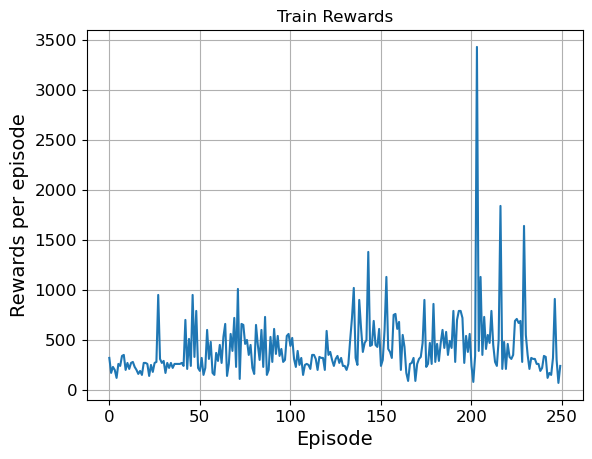

In [30]:
import matplotlib.pyplot as plt

plt.plot(train_monitor.get_episode_rewards())
plt.xlabel("Episode")
plt.ylabel("Rewards per episode")
plt.title("Train Rewards")
plt.grid()
plt.show()

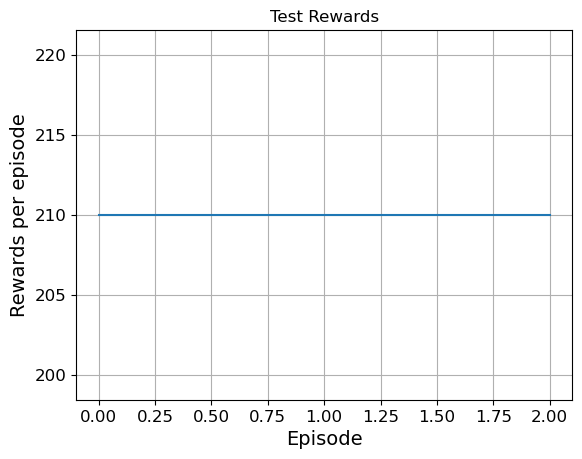

In [31]:
import matplotlib.pyplot as plt

plt.plot(test_monitor.get_episode_rewards())
plt.xlabel("Episode")
plt.ylabel("Rewards per episode")
plt.title("Test Rewards")
plt.grid()
plt.show()